In [13]:
import os, sys
# HOME = os.environ['HOME']  # change if necessary
HOME = '/workspace/wilson'
sys.path.append(f'{HOME}/Finite-groups/src')

import torch as t
import numpy as np
from matplotlib import pyplot as plt
import json
from itertools import product
from jaxtyping import Float
from torch.utils.data import DataLoader
from tqdm.notebook import tqdm
import plotly.graph_objects as go
import copy
import math
from itertools import product
import pandas as pd
from typing import Union
from einops import repeat
from huggingface_hub import snapshot_download
from huggingface_hub.utils import disable_progress_bars


from model import MLP3, MLP4, InstancedModule
from utils import *
from group_data import *
from model_utils import *
from group_utils import *
from llc import *
from generalization_measures import *
from hessian import *
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [14]:
device = t.device("cuda" if t.cuda.is_available() else "cpu")

In [15]:
MODEL_DIR = '2025-01-19_02-04-16_S5_MLP2_128_wd2e-5_inst1'
disable_progress_bars()
local_dir = f'{HOME}/models/{MODEL_DIR}'
if not os.path.exists(local_dir):
    snapshot_download(repo_id='wiwu2390/{MODEL_DIR}', local_dir=local_dir)
models, params = load_models(local_dir, sel=slice(0, -1, 3))

# IMPORTANT: set seed before creating data (which samples train_data)
t.manual_seed(params.seed)
np.random.seed(params.seed)
random.seed(params.seed)

data = GroupData(params)
init_models = MLP2.stack([models[0]] * len(models)).to(device)
models = MLP2.stack(models).to(device)

  0%|          | 0/667 [00:00<?, ?it/s]/workspace/wilson/Finite-groups/src/model_utils.py:57: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(t.load(mode

Intersection size: 14400/14400 (1.00)
Added 14400 elements from intersection
Added 0 elements from group 0: S(5)
Taking random subset: 5760/14400 (0.40)
Train set size: 5760/14400 (0.40)


In [4]:
loss_dict = load_loss_trajectory(local_dir)
loss_dict = {k: v.squeeze()[::3] for k, v in loss_dict.items()}
loss_dict['gen_error'] = loss_dict['epoch_train_acc'] - loss_dict['G0_acc']

/workspace/wilson/Finite-groups/src/utils.py:154: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  losses = [t.load(f) for f in loss_files if 'final.pt' not in f]


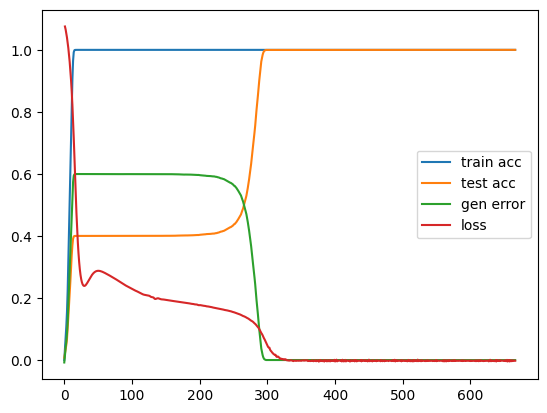

In [12]:
plt.plot(loss_dict['epoch_train_acc'].squeeze().cpu().detach().numpy(), label='train acc')
plt.plot(loss_dict['G0_acc'].squeeze().cpu().detach().numpy(), label='test acc')
plt.plot(loss_dict['gen_error'].squeeze().cpu().detach().numpy(), label='gen error')
plt.plot(((t.log(loss_dict['epoch_train_loss']) + 6)/7).squeeze().cpu().detach().numpy(), label='loss')
plt.legend()
plt.show()

In [7]:
# measures = dict()
measures = t.load('/workspace/wilson/Finite-groups/data/S5_measures.pt')

/tmp/ipykernel_6807/1735692738.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  measures = t.load('/workspace/wilson/Finite-groups/data/S5_measures.pt')


In [8]:
measures |= get_gen_measures(init_models, models, data)

MARGIN


OutOfMemoryError: CUDA out of memory. Tried to allocate 1.83 GiB. GPU 0 has a total capacity of 47.43 GiB of which 1.36 GiB is free. Process 2001076 has 22.53 GiB memory in use. Process 2222428 has 15.34 GiB memory in use. Process 2209979 has 8.18 GiB memory in use. Of the allocated memory 6.27 GiB is allocated by PyTorch, and 1.61 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [7]:
measures['LOG_INVERSE_MARGIN'] = t.log(measures['INVERSE_MARGIN'])
measures['LOG_TRAIN_LOSS'] = t.log(loss_dict['epoch_train_loss'].squeeze())

In [6]:
LLC_PARAMS = {
    'eps': 8e-4,
    'beta': 1e3,
    'gamma': 1.,
    'chains': 5,
    'cbatch_size': 1,
    'replacement': False,
    'behavioral': False,
    'epochs': 3000,
}
llc, traces = get_llc(models, data, **LLC_PARAMS)

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

In [10]:
measures['LLC'] = llc

In [ ]:
measures['HESSIAN_TRACE'] = h_tr(models, data)

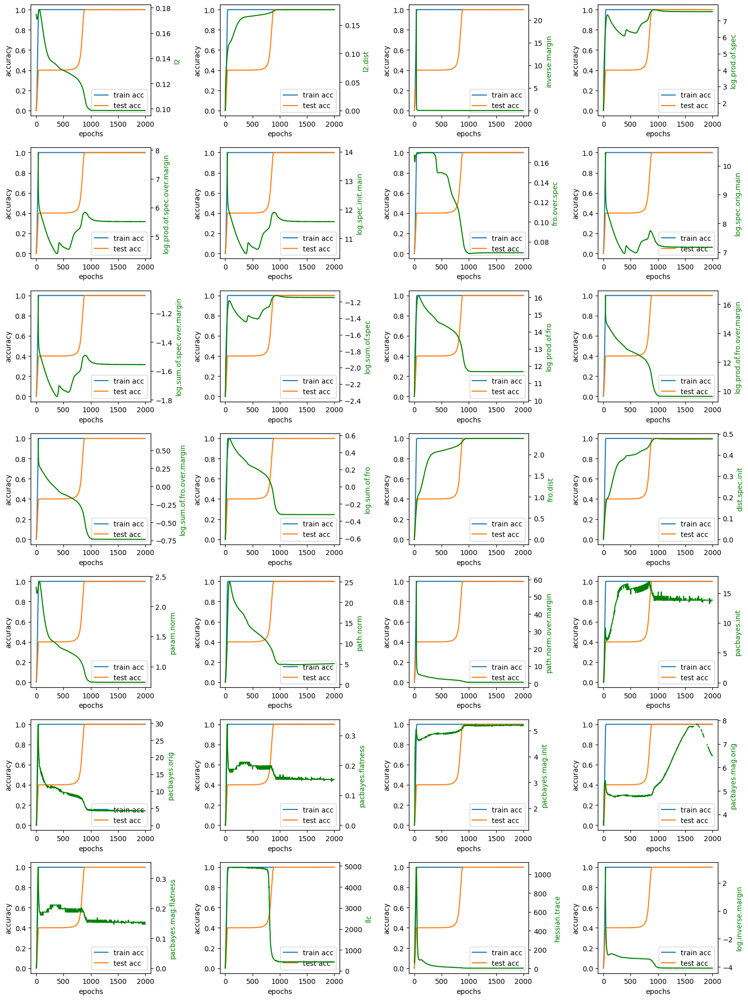

In [20]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

epochs = np.arange(0, 2000, 3)

fig, axs = plt.subplots(7, 4, figsize=(15, 20))
for i, (k, v) in enumerate(measures.items()):
    ax1 = axs[i // 4, i % 4]

    ax1.set_xlabel('epochs')
    ax1.set_ylabel('accuracy')
    ax1.plot(epochs, loss_dict['epoch_train_acc'].cpu().numpy(), label='train acc')
    ax1.plot(epochs, loss_dict['G0_acc'].cpu().numpy(), label='test acc')
    ax1.legend()

    ax2 = ax1.twinx()

    k = k.lower().replace('_', '.')
    ax2.set_ylabel(k, c='green')  # we already handled the x-label with ax1
    ax2.plot(epochs, v.detach().cpu().numpy(), label=k, c='green')

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

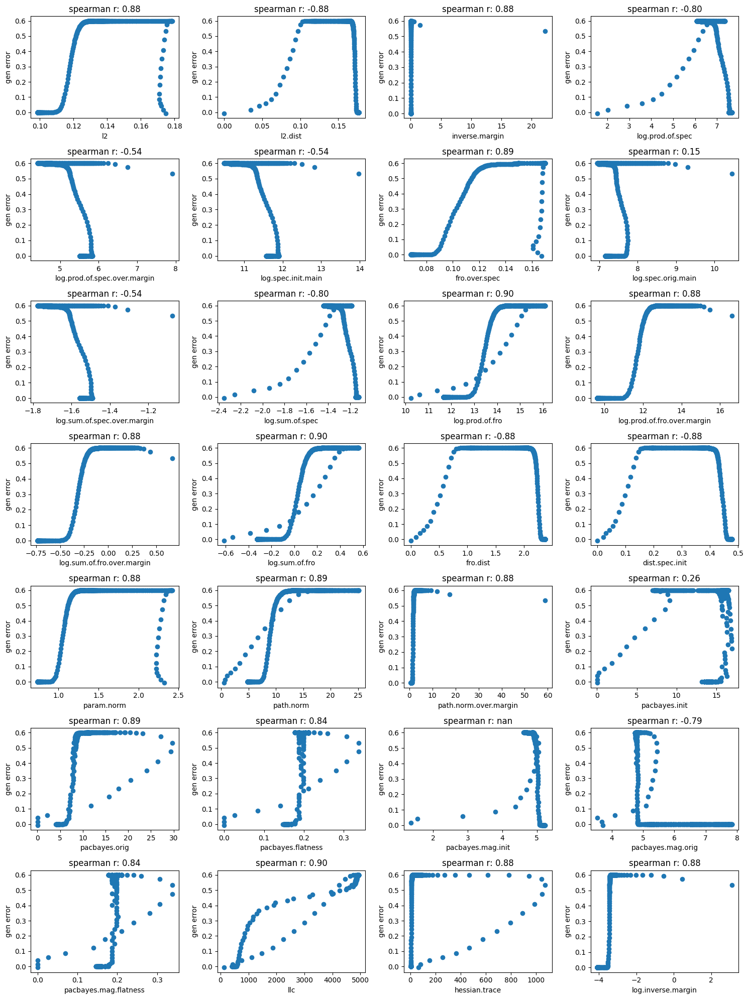

In [28]:
from scipy.stats import spearmanr, kendalltau
epochs = np.arange(0, 2000, 3)

fig, axs = plt.subplots(7, 4, figsize=(15, 20))
for i, (k, v) in enumerate(measures.items()):
    ax = axs[i // 4, i % 4]
    k = k.lower().replace('_', '.')
    ax.set_ylabel('gen error')
    ax.set_xlabel(k)
    r = spearmanr(v.detach().cpu().numpy(), loss_dict['gen_error'].cpu().numpy())[0]
    # r = kendalltau(v.detach().cpu().numpy(), loss_dict['gen_error'].cpu().numpy())[0]
    ax.scatter(v.detach().cpu().numpy(), loss_dict['gen_error'].cpu().numpy())
    ax.set_title(f'spearman r: {r:.2f}')

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

In [7]:
t.save(measures, '/workspace/wilson/Finite-groups/data/S5_measures.pt')
# measures = t.load('/workspace/wilson/Finite-groups/data/S5_measures.pt')

NameError: name 'measures' is not defined

### Circuit efficiency

In [16]:
def scale_model(model, scale):
    model = copy.deepcopy(model)
    for name, p in model.named_parameters():
        if 'bias' in name:
            p.data *= scale**3
        else:
            p.data *= scale
    return model

In [37]:
scaled_losses = []
scaled_norms = []
scales = 2 ** np.linspace(-6, 3, 500)
train_data = t.tensor(data.train_data)
train_x = train_data[:,:2].to(device)
train_z = train_data[:,2].to(device)

for i in tqdm(range(len(models))):
    model_scaled = MLP2.stack([scale_model(models[i], scale) for scale in scales])
    scaled_losses.append(get_cross_entropy(model_scaled(train_x), train_z).detach().cpu())
    scaled_norms.append(weight_norm(model_scaled).detach().cpu())


scaled_losses = np.stack(scaled_losses, axis=0)
scaled_norms = np.stack(scaled_norms, axis=0)
scaled_objs = scaled_losses + params.weight_decay/2 * scaled_norms**2


losses = get_cross_entropy(models(train_x), train_z).detach().cpu()
norms = weight_norm(models).detach().cpu()
objs = losses + params.weight_decay/2 * norms**2

  0%|          | 0/667 [00:00<?, ?it/s]

In [51]:
argmins = np.argmin(scaled_objs, axis=1)

In [55]:

frames = [
    go.Frame(
        data=[
            go.Scatter(x=scaled_norms[i], y=scaled_objs[i], mode='lines', name=''),
            go.Scatter(x=[scaled_norms[i][argmins[i]].item()], y=[scaled_objs[i][argmins[i]].item()], mode='markers', name='minimum', marker=dict(size=10, color='green')),
            go.Scatter(x=[norms[i].item()], y=[objs[i].item()], mode='markers', name='model', marker=dict(size=10, color='red')),
        ],
        name=f'frame{i}'
    ) 
    for i in range(scaled_norms.shape[0])
]

fig = go.Figure(
    data=frames[0].data,
    layout=go.Layout(
        title="Norm v Train objective",
        # xaxis=dict(range=[scaled_norms.min(), scaled_norms.max()]),
        xaxis=dict(range=[10, 300]),
        # yaxis=dict(range=[scaled_objs.min(), scaled_objs.max()]),
        yaxis=dict(range=[0, 10]),
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(
                label="Play",
                method="animate",
                args=[None, dict(
                    frame=dict(duration=100, redraw=True),
                    fromcurrent=True,
                    mode='immediate'
                )]
            )]
        )]
    ),
    frames=frames
)


sliders = [
    dict(
        steps=[
            dict(
                method="animate",
                args=[
                    [f"frame{k}"],
                    dict(
                        mode="immediate",
                        frame=dict(duration=100, redraw=True),
                        transition=dict(duration=100),
                    ),
                ],
                label=f"{k*3}",
            )
            for k in range(scaled_norms.shape[0])
        ],
        transition=dict(duration=100),
        x=0,
        y=0,
        currentvalue=dict(
            font=dict(size=12), prefix="Epoch: ", visible=True, xanchor="left"
        ),
        len=1.0,
    )
]
menu = dict(
    type="buttons",
    showactive=False,
    buttons=[
        dict(
            label="Play",
            method="animate",
            args=[
                None,
                {
                    "frame": {"duration": 100, "redraw": True},
                    "fromcurrent": True,
                    "transition": {"duration": 100, "easing": "quadratic-in-out"},
                },
            ],
        ),
        dict(
            label="Pause",
            method="animate",
            args=[
                [None],
                {
                    "frame": {"duration": 0, "redraw": False},
                    "mode": "immediate",
                    "transition": {"duration": 0},
                },
            ],
        ),
    ],
)

fig.update_layout(sliders=sliders, updatemenus=[menu], xaxis_title='Weight norm', yaxis_title='Train objective')

fig.show()


In [56]:
fig.write_html('/workspace/wilson/Finite-groups/figs/S5_norm_v_train_obj_v_epoch.html')